In [38]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.api import qqplot
from statsmodels.formula.api import ols  #linear regression
from statsmodels.formula.api import logit   #logistic regression
from statsmodels.graphics.mosaicplot import mosaic # plot confusion matrix
import statsmodels.formula.api as sm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, StandardScaler
from sklearn.linear_model import LinearRegression, ElasticNet, Ridge, Lasso,LassoCV, BayesianRidge
# provides basic strategies for imputing (or filling in) missing values. 
from sklearn.impute import SimpleImputer

from sklearn.metrics import mean_squared_error
from sklearn.pipeline import Pipeline
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import f1_score, recall_score, precision_recall_curve, precision_score, roc_auc_score, roc_curve, accuracy_score

In [39]:
data= pd.read_csv(r"C:\Users\mei88\Downloads\conversion_data.csv")

In [40]:
data.head()

,Unnamed: 0,visitor_id,visitor_location,marketing_channel,gender,product_views_Mon,product_views_Tue,product_views_Wed,product_views_Thu,product_views_Fri,...,time_on_site_Tue,time_on_site_Wed,time_on_site_Thu,time_on_site_Fri,pages_visited_Mon,pages_visited_Tue,pages_visited_Wed,pages_visited_Thu,pages_visited_Fri,converted_Fri
0,0,1,North America,youtube,M,4,5,2,1,2,...,33,23,46,57,4,5,5,4,6,1
1,1,2,South America,organic,F,2,5,0,1,5,...,28,39,24,51,5,6,7,6,2,0
2,2,3,Australia,instagram,M,3,4,0,-3,5,...,34,22,34,31,1,3,3,2,3,1
3,3,4,North America,facebook,M,1,0,0,5,0,...,26,43,22,39,3,4,7,7,1,0
4,4,5,Asia,instagram,F,1,5,2,2,3,...,54,30,47,57,6,6,5,2,4,1


### EDA

In [41]:
# no missing values
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 31 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2000 non-null   int64  
 1   visitor_id         2000 non-null   int64  
 2   visitor_location   2000 non-null   object 
 3   marketing_channel  2000 non-null   object 
 4   gender             2000 non-null   object 
 5   product_views_Mon  2000 non-null   int64  
 6   product_views_Tue  2000 non-null   int64  
 7   product_views_Wed  2000 non-null   int64  
 8   product_views_Thu  2000 non-null   int64  
 9   product_views_Fri  2000 non-null   int64  
 10  avg_rating_Mon     2000 non-null   float64
 11  avg_rating_Tue     2000 non-null   float64
 12  avg_rating_Wed     2000 non-null   float64
 13  avg_rating_Thu     2000 non-null   float64
 14  avg_rating_Fri     2000 non-null   float64
 15  avg_price_Mon      2000 non-null   float64
 16  avg_price_Tue      2000 

In [42]:
df.describe(include='all')

,Unnamed: 0,visitor_id,visitor_location,marketing_channel,gender,product_views_Mon,product_views_Tue,product_views_Wed,product_views_Thu,product_views_Fri,...,time_on_site_Tue,time_on_site_Wed,time_on_site_Thu,time_on_site_Fri,pages_visited_Mon,pages_visited_Tue,pages_visited_Wed,pages_visited_Thu,pages_visited_Fri,converted_Fri
count,2000.000000,2000.000000,2000,2000,2000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
unique,NaN,NaN,5,5,2,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,South America,instagram,F,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,433,431,1093,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,999.500000,1000.500000,NaN,NaN,NaN,2.541500,2.440500,2.441000,2.256500,2.354000,...,39.776500,40.155500,40.417000,40.028500,3.946000,4.071000,4.092500,3.921000,4.089500,0.372000
std,577.494589,577.494589,NaN,NaN,NaN,1.704914,1.715206,2.343345,2.370974,2.335682,...,11.855624,11.757399,11.892638,11.664207,2.010001,2.012209,2.002985,2.023316,2.026954,0.483459
min,0.000000,1.000000,NaN,NaN,NaN,0.000000,0.000000,0.000000,-4.000000,-3.000000,...,20.000000,20.000000,20.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
25%,499.750000,500.750000,NaN,NaN,NaN,1.000000,1.000000,0.000000,0.000000,0.000000,...,29.000000,30.000000,30.000000,30.000000,2.000000,2.000000,2.000000,2.000000,2.000000,0.000000
50%,999.500000,1000.500000,NaN,NaN,NaN,3.000000,2.000000,2.000000,2.000000,2.000000,...,40.000000,40.000000,40.500000,40.000000,4.000000,4.000000,4.000000,4.000000,4.000000,0.000000
75%,1499.250000,1500.250000,NaN,NaN,NaN,4.000000,4.000000,4.000000,5.000000,5.000000,...,50.000000,50.000000,51.000000,50.000000,6.000000,6.000000,6.000000,6.000000,6.000000,1.000000


In [43]:
data.columns

Index(['Unnamed: 0', 'visitor_id', 'visitor_location', 'marketing_channel',
       'gender', 'product_views_Mon', 'product_views_Tue', 'product_views_Wed',
       'product_views_Thu', 'product_views_Fri', 'avg_rating_Mon',
       'avg_rating_Tue', 'avg_rating_Wed', 'avg_rating_Thu', 'avg_rating_Fri',
       'avg_price_Mon', 'avg_price_Tue', 'avg_price_Wed', 'avg_price_Thu',
       'avg_price_Fri', 'time_on_site_Mon', 'time_on_site_Tue',
       'time_on_site_Wed', 'time_on_site_Thu', 'time_on_site_Fri',
       'pages_visited_Mon', 'pages_visited_Tue', 'pages_visited_Wed',
       'pages_visited_Thu', 'pages_visited_Fri', 'converted_Fri'],
      dtype='object')

In [44]:
sns.pairplot(data, hue='converted_Fri')

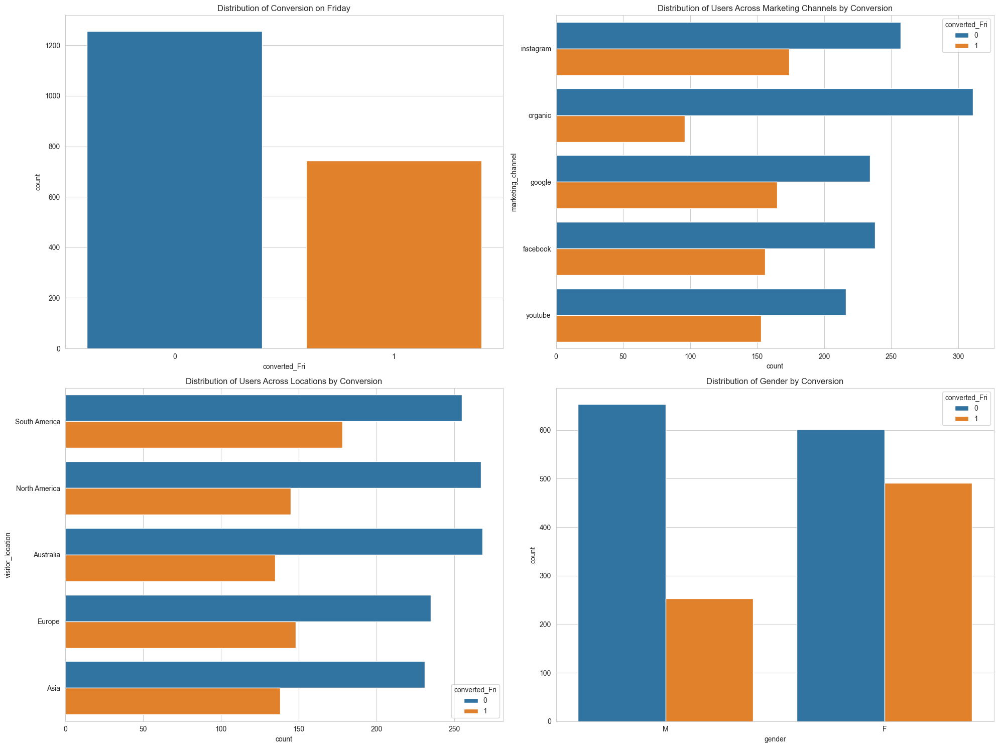

In [52]:

# Initializing the figure
plt.figure(figsize=(20, 15))

# Plotting the distribution of 'converted_Fri' column
plt.subplot(2, 2, 1)
sns.countplot(data=data, x='converted_Fri')
plt.title("Distribution of Conversion on Friday")

# Plotting the distribution of users across different marketing channels
plt.subplot(2, 2, 2)
sns.countplot(data=data, y='marketing_channel', hue='converted_Fri', order=data['marketing_channel'].value_counts().index)
plt.title("Distribution of Users Across Marketing Channels by Conversion")

# Plotting the distribution of users across different locations
plt.subplot(2, 2, 3)
sns.countplot(data=data, y='visitor_location', hue='converted_Fri', order=data['visitor_location'].value_counts().index)
plt.title("Distribution of Users Across Locations by Conversion")

# Plotting the distribution of gender
plt.subplot(2, 2, 4)
sns.countplot(data=data, x='gender', hue='converted_Fri')
plt.title("Distribution of Gender by Conversion")

plt.tight_layout()
plt.show()


Insights 

-Organic and Youtube channels have the highest traffic. but Instagram and google have higher conversion

South America has the highest conversion, Australia has the least

-female has higher conversion

-

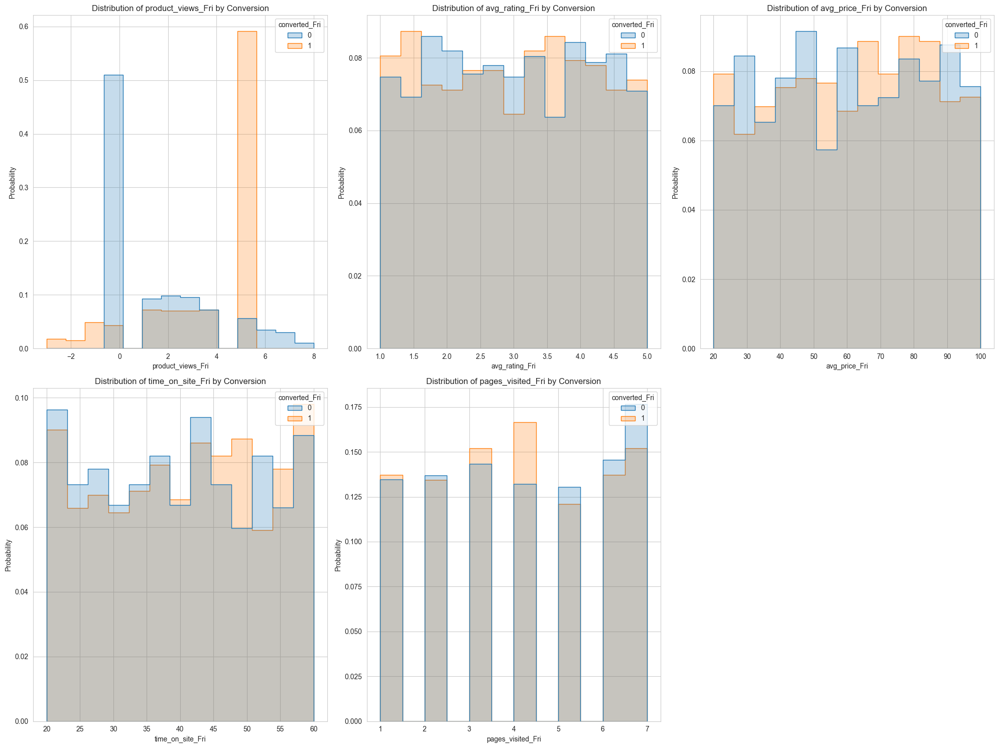

In [53]:
# Initializing the figure
plt.figure(figsize=(20, 15))

# List of behavioral features to analyze
behavioral_features = ['product_views_Fri', 'avg_rating_Fri', 'avg_price_Fri', 'time_on_site_Fri', 'pages_visited_Fri']

# Looping through each feature and plotting its distribution for converted and non-converted users
for index, feature in enumerate(behavioral_features, 1):
    plt.subplot(2, 3, index)
    sns.histplot(data=data, x=feature, hue='converted_Fri', element="step", stat="probability", common_norm=False)
    plt.title(f"Distribution of {feature} by Conversion")

plt.tight_layout()
plt.show()


Insights:

- product_review is higher on conversion user
- average rating is higher for conversion user 
- price variable is similar for both converted and non-converted. 
- Time-spent is higher on conversion user
- Page-visited is higher on conversion user


### Hypothesis

Users who view products with higher ratings are more likely to convert.
Users who spend more time on the site and visit more pages are more likely to convert.
Marketing channels and demographic factors like location and gender might influence conversion rates.

we will find more details later


In [68]:
# Data Cleaning

# Dropping unnecessary columns
data_cleaned = data.drop(columns=["Unnamed: 0", "visitor_id"])

# Converting categorical variables into numerical format using one-hot encoding
data_cleaned = pd.get_dummies(data_cleaned, columns=['visitor_location', 'marketing_channel', 'gender'], dtype=int)

# Creating aggregate features
days = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri']
data_cleaned['total_product_views'] = data_cleaned[[f'product_views_{day}' for day in days]].sum(axis=1)
data_cleaned['avg_rating_week'] = data_cleaned[[f'avg_rating_{day}' for day in days]].mean(axis=1)
data_cleaned['avg_price_week'] = data_cleaned[[f'avg_price_{day}' for day in days]].mean(axis=1)
data_cleaned['total_time_on_site'] = data_cleaned[[f'time_on_site_{day}' for day in days]].sum(axis=1)
data_cleaned['total_pages_visited'] = data_cleaned[[f'pages_visited_{day}' for day in days]].sum(axis=1)

data_cleaned.head()



,product_views_Mon,product_views_Tue,product_views_Wed,product_views_Thu,product_views_Fri,avg_rating_Mon,avg_rating_Tue,avg_rating_Wed,avg_rating_Thu,avg_rating_Fri,...,marketing_channel_instagram,marketing_channel_organic,marketing_channel_youtube,gender_F,gender_M,total_product_views,avg_rating_week,avg_price_week,total_time_on_site,total_pages_visited
0,4,5,2,1,2,3.90,2.19,4.87,3.47,1.24,...,0,0,1,0,1,14,3.134,54.738,216,24
1,2,5,0,1,5,1.31,2.16,1.98,3.09,1.80,...,0,1,0,1,0,13,2.068,71.432,166,26
2,3,4,0,-3,5,3.26,4.79,3.12,2.58,4.58,...,1,0,0,0,1,9,3.666,64.358,144,12
3,1,0,0,5,0,2.66,4.79,3.41,2.28,3.36,...,0,0,0,0,1,6,3.300,56.048,186,22
4,1,5,2,2,3,2.76,2.38,3.32,1.62,1.74,...,1,0,0,1,0,13,2.364,46.442,223,23


In [63]:
data_cleaned.columns

Index(['product_views_Mon', 'product_views_Tue', 'product_views_Wed',
       'product_views_Thu', 'product_views_Fri', 'avg_rating_Mon',
       'avg_rating_Tue', 'avg_rating_Wed', 'avg_rating_Thu', 'avg_rating_Fri',
       'avg_price_Mon', 'avg_price_Tue', 'avg_price_Wed', 'avg_price_Thu',
       'avg_price_Fri', 'time_on_site_Mon', 'time_on_site_Tue',
       'time_on_site_Wed', 'time_on_site_Thu', 'time_on_site_Fri',
       'pages_visited_Mon', 'pages_visited_Tue', 'pages_visited_Wed',
       'pages_visited_Thu', 'pages_visited_Fri', 'converted_Fri',
       'visitor_location_Asia', 'visitor_location_Australia',
       'visitor_location_Europe', 'visitor_location_North America',
       'visitor_location_South America', 'marketing_channel_facebook',
       'marketing_channel_google', 'marketing_channel_instagram',
       'marketing_channel_organic', 'marketing_channel_youtube', 'gender_F',
       'gender_M', 'total_product_views', 'avg_rating_week', 'avg_price_week',
       'total_time_

In [69]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 31 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2000 non-null   int64  
 1   visitor_id         2000 non-null   int64  
 2   visitor_location   2000 non-null   object 
 3   marketing_channel  2000 non-null   object 
 4   gender             2000 non-null   object 
 5   product_views_Mon  2000 non-null   int64  
 6   product_views_Tue  2000 non-null   int64  
 7   product_views_Wed  2000 non-null   int64  
 8   product_views_Thu  2000 non-null   int64  
 9   product_views_Fri  2000 non-null   int64  
 10  avg_rating_Mon     2000 non-null   float64
 11  avg_rating_Tue     2000 non-null   float64
 12  avg_rating_Wed     2000 non-null   float64
 13  avg_rating_Thu     2000 non-null   float64
 14  avg_rating_Fri     2000 non-null   float64
 15  avg_price_Mon      2000 non-null   float64
 16  avg_price_Tue      2000 

In [70]:
data_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 43 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   product_views_Mon               2000 non-null   int64  
 1   product_views_Tue               2000 non-null   int64  
 2   product_views_Wed               2000 non-null   int64  
 3   product_views_Thu               2000 non-null   int64  
 4   product_views_Fri               2000 non-null   int64  
 5   avg_rating_Mon                  2000 non-null   float64
 6   avg_rating_Tue                  2000 non-null   float64
 7   avg_rating_Wed                  2000 non-null   float64
 8   avg_rating_Thu                  2000 non-null   float64
 9   avg_rating_Fri                  2000 non-null   float64
 10  avg_price_Mon                   2000 non-null   float64
 11  avg_price_Tue                   2000 non-null   float64
 12  avg_price_Wed                   20

In [71]:
data_cleaned.columns

Index(['product_views_Mon', 'product_views_Tue', 'product_views_Wed',
       'product_views_Thu', 'product_views_Fri', 'avg_rating_Mon',
       'avg_rating_Tue', 'avg_rating_Wed', 'avg_rating_Thu', 'avg_rating_Fri',
       'avg_price_Mon', 'avg_price_Tue', 'avg_price_Wed', 'avg_price_Thu',
       'avg_price_Fri', 'time_on_site_Mon', 'time_on_site_Tue',
       'time_on_site_Wed', 'time_on_site_Thu', 'time_on_site_Fri',
       'pages_visited_Mon', 'pages_visited_Tue', 'pages_visited_Wed',
       'pages_visited_Thu', 'pages_visited_Fri', 'converted_Fri',
       'visitor_location_Asia', 'visitor_location_Australia',
       'visitor_location_Europe', 'visitor_location_North America',
       'visitor_location_South America', 'marketing_channel_facebook',
       'marketing_channel_google', 'marketing_channel_instagram',
       'marketing_channel_organic', 'marketing_channel_youtube', 'gender_F',
       'gender_M', 'total_product_views', 'avg_rating_week', 'avg_price_week',
       'total_time_

Using logistic Regression to check the correlations of the independent variables with target variables.

In [72]:
from sklearn.linear_model import LogisticRegression

In [74]:
log = LogisticRegression()

log.fit(data_cleaned[['product_views_Mon', 'product_views_Tue', 'product_views_Wed',
       'product_views_Thu', 'product_views_Fri', 'avg_rating_Mon',
       'avg_rating_Tue', 'avg_rating_Wed', 'avg_rating_Thu', 'avg_rating_Fri',
       'avg_price_Mon', 'avg_price_Tue', 'avg_price_Wed', 'avg_price_Thu',
       'avg_price_Fri', 'time_on_site_Mon', 'time_on_site_Tue',
       'time_on_site_Wed', 'time_on_site_Thu', 'time_on_site_Fri',
       'pages_visited_Mon', 'pages_visited_Tue', 'pages_visited_Wed',
       'pages_visited_Thu', 'pages_visited_Fri', 'converted_Fri',
       'visitor_location_Asia', 'visitor_location_Australia',
       'visitor_location_Europe', 'visitor_location_North America',
       'visitor_location_South America', 'marketing_channel_facebook',
       'marketing_channel_google', 'marketing_channel_instagram',
       'marketing_channel_organic', 'marketing_channel_youtube', 'gender_F',
       'gender_M', 'total_product_views', 'avg_rating_week', 'avg_price_week',
       'total_time_on_site', 'total_pages_visited']], data_cleaned['converted_Fri'])


C:\Users\mei88\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [76]:

pred = log.predict(data_cleaned[['product_views_Mon', 'product_views_Tue', 'product_views_Wed',
       'product_views_Thu', 'product_views_Fri', 'avg_rating_Mon',
       'avg_rating_Tue', 'avg_rating_Wed', 'avg_rating_Thu', 'avg_rating_Fri',
       'avg_price_Mon', 'avg_price_Tue', 'avg_price_Wed', 'avg_price_Thu',
       'avg_price_Fri', 'time_on_site_Mon', 'time_on_site_Tue',
       'time_on_site_Wed', 'time_on_site_Thu', 'time_on_site_Fri',
       'pages_visited_Mon', 'pages_visited_Tue', 'pages_visited_Wed',
       'pages_visited_Thu', 'pages_visited_Fri', 'converted_Fri',
       'visitor_location_Asia', 'visitor_location_Australia',
       'visitor_location_Europe', 'visitor_location_North America',
       'visitor_location_South America', 'marketing_channel_facebook',
       'marketing_channel_google', 'marketing_channel_instagram',
       'marketing_channel_organic', 'marketing_channel_youtube', 'gender_F',
       'gender_M', 'total_product_views', 'avg_rating_week', 'avg_price_week',
       'total_time_on_site', 'total_pages_visited']])

In [77]:
print(accuracy_score(pred,data['converted_Fri']))
print(f1_score(pred,data['converted_Fri']))
print(precision_score(pred,data['converted_Fri']))
print(recall_score(pred,data['converted_Fri']))

1.0
1.0
1.0
1.0


based on the result, it is overfitting

In [78]:

pd.DataFrame([log.feature_names_in_,log.coef_.flatten()]).T

,0,1
0,product_views_Mon,-0.062607
1,product_views_Tue,0.024658
2,product_views_Wed,-0.092782
3,product_views_Thu,0.049476
4,product_views_Fri,0.132261
5,avg_rating_Mon,0.175995
6,avg_rating_Tue,-0.038471
7,avg_rating_Wed,-0.067235
8,avg_rating_Thu,-0.397232
9,avg_rating_Fri,-0.223911


the correlationship result is not reliable, we are tying other models

In [79]:

x = data_cleaned[['product_views_Mon', 'product_views_Tue', 'product_views_Wed',
       'product_views_Thu', 'product_views_Fri', 'avg_rating_Mon',
       'avg_rating_Tue', 'avg_rating_Wed', 'avg_rating_Thu', 'avg_rating_Fri',
       'avg_price_Mon', 'avg_price_Tue', 'avg_price_Wed', 'avg_price_Thu',
       'avg_price_Fri', 'time_on_site_Mon', 'time_on_site_Tue',
       'time_on_site_Wed', 'time_on_site_Thu', 'time_on_site_Fri',
       'pages_visited_Mon', 'pages_visited_Tue', 'pages_visited_Wed',
       'pages_visited_Thu', 'pages_visited_Fri', 'converted_Fri',
       'visitor_location_Asia', 'visitor_location_Australia',
       'visitor_location_Europe', 'visitor_location_North America',
       'visitor_location_South America', 'marketing_channel_facebook',
       'marketing_channel_google', 'marketing_channel_instagram',
       'marketing_channel_organic', 'marketing_channel_youtube', 'gender_F',
       'gender_M', 'total_product_views', 'avg_rating_week', 'avg_price_week',
       'total_time_on_site', 'total_pages_visited']]
y = data_cleaned['converted_Fri']

In [80]:
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.2, random_state=1234)

In [81]:
from sklearn.svm import SVC

In [83]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score, RandomizedSearchCV
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, recall_score, precision_recall_curve, precision_score, roc_auc_score, roc_curve, accuracy_score

In [84]:
knn = KNeighborsClassifier()
log = LogisticRegression()
nb = GaussianNB()
svc = SVC(kernel='linear')

In [85]:

knn.fit(x_train, y_train)
log.fit(x_train, y_train)
nb.fit(x_train, y_train)
svc.fit(x_train, y_train)

C:\Users\mei88\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


SVC(kernel='linear')

In [86]:

pred_knn = knn.predict(x_test)
pred_log = log.predict(x_test)
pred_nb = nb.predict(x_test)
pred_sv = svc.predict(x_test)

In [87]:

print(f1_score(pred_knn,y_test))
print(f1_score(pred_log,y_test))
print(f1_score(pred_nb,y_test))
print(f1_score(pred_sv,y_test))


0.4061302681992337
0.9788732394366197
1.0
1.0


### Since it still have over-fitting. we are using machine learing to build models and  see how they performance

In [91]:
data= data.drop(columns=["Unnamed: 0", "visitor_id"])

In [92]:
data.columns

Index(['visitor_location', 'marketing_channel', 'gender', 'product_views_Mon',
       'product_views_Tue', 'product_views_Wed', 'product_views_Thu',
       'product_views_Fri', 'avg_rating_Mon', 'avg_rating_Tue',
       'avg_rating_Wed', 'avg_rating_Thu', 'avg_rating_Fri', 'avg_price_Mon',
       'avg_price_Tue', 'avg_price_Wed', 'avg_price_Thu', 'avg_price_Fri',
       'time_on_site_Mon', 'time_on_site_Tue', 'time_on_site_Wed',
       'time_on_site_Thu', 'time_on_site_Fri', 'pages_visited_Mon',
       'pages_visited_Tue', 'pages_visited_Wed', 'pages_visited_Thu',
       'pages_visited_Fri', 'converted_Fri'],
      dtype='object')

0.5555555555555556
0.72


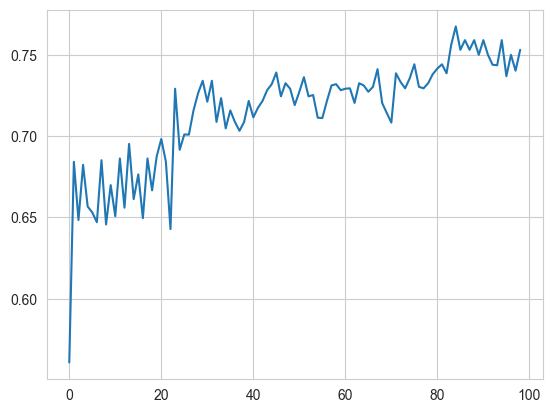

In [95]:
cat_columns = ['visitor_location', 'marketing_channel', 'gender']
num_columns = ['product_views_Mon','product_views_Tue', 'product_views_Wed', 'product_views_Thu',
       'product_views_Fri', 'avg_rating_Mon', 'avg_rating_Tue',
       'avg_rating_Wed', 'avg_rating_Thu', 'avg_rating_Fri', 'avg_price_Mon',
       'avg_price_Tue', 'avg_price_Wed', 'avg_price_Thu', 'avg_price_Fri',
       'time_on_site_Mon', 'time_on_site_Tue', 'time_on_site_Wed',
       'time_on_site_Thu', 'time_on_site_Fri', 'pages_visited_Mon',
       'pages_visited_Tue', 'pages_visited_Wed', 'pages_visited_Thu',
       'pages_visited_Fri',]
target = 'converted_Fri'


# build pipeline
# pipeline can do data clearning and variaable preparation
cat_transformer = OneHotEncoder(handle_unknown='ignore') # does not have model in it.
num_transformer = StandardScaler()
preprocessor = ColumnTransformer(transformers = [('cat',cat_transformer, cat_columns),
                                                 ('num', num_transformer, num_columns)])

# train test split
X_train, X_test, y_train, y_test = train_test_split(df[cat_columns + num_columns], df[target], test_size=0.2, random_state=42)

# transform dataset using pipeline
# scaling, feature engineering
x_train_transformed = preprocessor.fit_transform(X_train)
x_test_transformed = preprocessor.fit_transform(X_test)

x_train_transformed.shape
x_test_transformed.shape

# encoding columns and features
encoded_columns = list(preprocessor.named_transformers_['cat'].get_feature_names_out(cat_columns))
all_feat = num_columns + encoded_columns

X_train_transformed = pd.DataFrame(x_train_transformed, columns=all_feat)
X_test_transformed = pd.DataFrame(x_test_transformed, columns=all_feat)


knn = KNeighborsClassifier(n_neighbors = 40)
knn.fit(X_train_transformed, y_train)
y_pred = knn.predict(X_test_transformed)
print(f1_score(y_pred, y_test))
print(accuracy_score(y_pred, y_test))


recall = []

for a in range(1,100):
    knn = KNeighborsClassifier(n_neighbors = a)
    knn.fit(X_train_transformed, y_train)
    y_pred = knn.predict(X_test_transformed)
    # print(f1_score(y_pred, y_test))
    
    recall.append(recall_score(y_pred, y_test))
    
       
plt.plot(recall)






In [118]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, accuracy_score
from sklearn.pipeline import Pipeline


# KNN Model
knn_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', KNeighborsClassifier(n_neighbors=40))
])
knn_pipeline.fit(X_train, y_train)
y_pred_knn = knn_pipeline.predict(X_test)
print("KNN Model:")
print(f"F1 Score: {f1_score(y_test, y_pred_knn)}")
print(f"Accuracy: {accuracy_score(y_test, y_pred_knn)}")
print(f"Recall: {recall_score(y_test, y_pred_knn)}")
print(f"Precision: {precision_score(y_test, y_pred_knn)}")

# Decision Tree Model
dt_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', DecisionTreeClassifier(random_state=42))
])
dt_pipeline.fit(X_train, y_train)
y_pred_dt = dt_pipeline.predict(X_test)
print("Decision Tree Model:")
print(f"F1 Score: {f1_score(y_test, y_pred_dt)}")
print(f"Accuracy: {accuracy_score(y_test, y_pred_dt)}")
print(f"Recall: {recall_score(y_test, y_pred_dt)}")
print(f"Precision: {precision_score(y_test, y_pred_dt)}")

# SVM Model
svm_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', SVC())
])
svm_pipeline.fit(X_train, y_train)
y_pred_svm = svm_pipeline.predict(X_test)
print("SVM Model:")
print(f"F1 Score: {f1_score(y_test, y_pred_svm)}")
print(f"Accuracy: {accuracy_score(y_test, y_pred_svm)}")
print(f"Recall: {recall_score(y_test, y_pred_svm)}")
print(f"Precision: {precision_score(y_test, y_pred_svm)}")

# Logistic Regression Model
logreg_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression(max_iter=1000))
])
logreg_pipeline.fit(X_train, y_train)
y_pred_logreg = logreg_pipeline.predict(X_test)
print("Logistic Regression Model:")
print(f"F1 Score: {f1_score(y_test, y_pred_logreg)}")
print(f"Accuracy: {accuracy_score(y_test, y_pred_logreg)}")
print(f"Recall: {recall_score(y_test, y_pred_logreg)}")
print(f"Precision: {precision_score(y_test, y_pred_logreg)}")



# Gaussian Naive Bayes Model
nb_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', GaussianNB())
])
nb_pipeline.fit(X_train, y_train)
y_pred_nb = nb_pipeline.predict(X_test)
print("Naive Bayes Model:")
print(f"F1 Score: {f1_score(y_test, y_pred_nb)}")
print(f"Accuracy: {accuracy_score(y_test, y_pred_nb)}")
print(f"Recall: {recall_score(y_test, y_pred_nb)}")
print(f"Precision: {precision_score(y_test, y_pred_nb)}")



KNN Model:
F1 Score: 0.5533596837944664
Accuracy: 0.7175
Recall: 0.45161290322580644
Precision: 0.7142857142857143
Decision Tree Model:
F1 Score: 0.8490566037735848
Accuracy: 0.88
Recall: 0.8709677419354839
Precision: 0.8282208588957055
SVM Model:
F1 Score: 0.6524822695035462
Accuracy: 0.755
Recall: 0.5935483870967742
Precision: 0.7244094488188977
Logistic Regression Model:
F1 Score: 0.653061224489796
Accuracy: 0.745
Recall: 0.6193548387096774
Precision: 0.6906474820143885
Naive Bayes Model:
F1 Score: 0.6533333333333332
Accuracy: 0.74
Recall: 0.632258064516129
Precision: 0.6758620689655173


In [123]:
models = ["KNN", "Decision Tree", "SVM", "Logistic Regression", "Naive Bayes"]
predictions = [y_pred_knn, y_pred_dt, y_pred_svm, y_pred_logreg, y_pred_nb]

f1_scores = [f1_score(y_test, pred) for pred in predictions]
accuracy_scores = [accuracy_score(y_test, pred) for pred in predictions]
recall_scores = [recall_score(y_test, pred) for pred in predictions]
precision_scores = [precision_score(y_test, pred) for pred in predictions]
# Creating a DataFrame to compare the performance
performance_df = pd.DataFrame({
    'Model': models,
    'F1 Score': f1_scores,
    'Accuracy': accuracy_scores,
    'Recall': recall_scores,
    'Precision': precision_scores
})

print(performance_df)

                 Model  F1 Score  Accuracy    Recall  Precision
0                  KNN  0.553360    0.7175  0.451613   0.714286
1        Decision Tree  0.849057    0.8800  0.870968   0.828221
2                  SVM  0.652482    0.7550  0.593548   0.724409
3  Logistic Regression  0.653061    0.7450  0.619355   0.690647
4          Naive Bayes  0.653333    0.7400  0.632258   0.675862


Decision Tree has the best F1 score among all of the models

### Now we use cross-validation to build the model again and compare the performance

In [124]:
from sklearn.model_selection import cross_val_score

# Define models
models_cv = {
    'KNN': KNeighborsClassifier(),
    'Logistic Regression': LogisticRegression(max_iter=1000),
    'GaussianNB': GaussianNB(),
    'SVC': SVC(kernel='linear')
}

# Perform 5-fold cross-validation and store F1 scores
f1_scores_cv = {}

for name, model in models_cv.items():
    cv_f1 = cross_val_score(model, x_train, y_train, cv=5, scoring='f1')
    f1_scores_cv[name] = {
        'Mean F1': cv_f1.mean(),
        'Standard Deviation': cv_f1.std()
    }

f1_scores_cv


C:\Users\mei88\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\mei88\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stab

{'KNN': {'Mean F1': 0.30823776963218696,
  'Standard Deviation': 0.05600189511881322},
 'Logistic Regression': {'Mean F1': 0.0715956209295999,
  'Standard Deviation': 0.04555721879291542},
 'GaussianNB': {'Mean F1': 0.2177902548575333,
  'Standard Deviation': 0.029362479572885476},
 'SVC': {'Mean F1': 0.0, 'Standard Deviation': 0.0}}

In [125]:
from sklearn.tree import DecisionTreeClassifier

# Update models_cv to include Decision Tree
models_cv.update({'Decision Tree': DecisionTreeClassifier(random_state=42)})

# We should use the preprocessed data for cross-validation
# Since preprocessing is part of the pipeline, let's fit and transform the entire dataset for cross-validation
X_preprocessed = preprocessor.fit_transform(df[cat_columns + num_columns])
y = df[target]

# Perform 5-fold cross-validation and store F1 scores
f1_scores_cv = {}

for name, model in models_cv.items():
    cv_f1 = cross_val_score(model, X_preprocessed, y, cv=5, scoring='f1')
    f1_scores_cv[name] = {
        'Mean F1': cv_f1.mean(),
        'Standard Deviation': cv_f1.std()
    }

f1_scores_cv


{'KNN': {'Mean F1': 0.582351268600686,
  'Standard Deviation': 0.02921300177766781},
 'Logistic Regression': {'Mean F1': 0.6274583947667226,
  'Standard Deviation': 0.011815724910385716},
 'GaussianNB': {'Mean F1': 0.6507327147312209,
  'Standard Deviation': 0.012599276419189294},
 'SVC': {'Mean F1': 0.6512744465728557,
  'Standard Deviation': 0.023902406353751182},
 'Decision Tree': {'Mean F1': 0.7939979790639453,
  'Standard Deviation': 0.03779954386233197}}

In [126]:
f1_scores_df = pd.DataFrame(f1_scores_cv).transpose()
print(f1_scores_df)


                      Mean F1  Standard Deviation
KNN                  0.582351            0.029213
Logistic Regression  0.627458            0.011816
GaussianNB           0.650733            0.012599
SVC                  0.651274            0.023902
Decision Tree        0.793998            0.037800


### Decision tree is the best model with highest F1 score

### Now we are tuning the parameters of decisioin tree model and find the best parameters

In [127]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

# Define the model
dt = DecisionTreeClassifier(random_state=42)

# Define the parameter grid
param_grid = {
    'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Use GridSearchCV
grid_search = GridSearchCV(estimator=dt, param_grid=param_grid, 
                           scoring='f1', cv=5, n_jobs=-1, verbose=2)

# Fit the model
grid_search.fit(X_preprocessed, y)

# Get the best parameters
best_params = grid_search.best_params_
best_score = grid_search.best_score_

best_params, best_score


Fitting 5 folds for each of 216 candidates, totalling 1080 fits


({'criterion': 'gini',
  'max_depth': 10,
  'min_samples_leaf': 2,
  'min_samples_split': 2,
  'splitter': 'best'},
 0.818481021074024)

### To output the best F1 score in decision tree model. the best parameters are :
Optimal Parameters:

    -Criterion: Gini impurity (gini).
    -Max Depth: 10. 
    -Minimum Samples Leaf: 2. 
    -Minimum Samples Split: 2.
    -Splitter: Best (best). 

Performance:

    With the optimal parameters, the Decision Tree model achieved an F1 score of approximately 0.8185 during cross-validation. This metric indicates a good balance between precision and recall.


### Now we are applying the best parameters to the model and find the factors impacting the conversion rate. 

In [128]:
# 1. Train the Decision Tree model with the best parameters
best_dt = DecisionTreeClassifier(
    criterion='gini',
    max_depth=10,
    min_samples_leaf=2,
    min_samples_split=2,
    splitter='best',
    random_state=42
)
best_dt.fit(X_preprocessed, y)

# 2. Extract the feature importances from the trained model
importances = best_dt.feature_importances_

# 3. Sort and visualize the features based on their importance
feature_importance_df = pd.DataFrame({
    'Feature': all_feat,  # all_feat contains names of all features (assuming you've defined it earlier)
    'Importance': importances
})

# Sorting the features based on importance
sorted_feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

sorted_feature_importance_df


,Feature,Importance
16,time_on_site_Tue,0.585234
15,time_on_site_Mon,0.190335
14,avg_price_Fri,0.063094
25,visitor_location_Asia,0.021518
31,marketing_channel_google,0.019960
20,pages_visited_Mon,0.014624
27,visitor_location_Europe,0.010823
29,visitor_location_South America,0.010558
22,pages_visited_Wed,0.010420
21,pages_visited_Tue,0.010131


time_on_site_tuesday, time_on_site_monday, avg_price_friday, Asia_location, google channel, pages_visited_monday, europe_location, south_america location have higher relations

## SUMMARY


We had preliminary hypothesis that channel, location, gender have impact to conversion rate such as  Instagram and google , South America has the highest conversion, Australia has the least, female has higher conversion. Users' behaviour such as time_spent, pages _visited output higher conversion rate. 

Data Cleaning and feature engineering: we dropped unnecessary columns, and generated dummy values. we also build logistic regression model to check the correlations.

Build models: we first mannually build a logistic regression model, it did not performe well.  then we manually build other models, suchs KNN, NB, SVM, two of them are overfitted. 

Machine Learning models: then we sepearted categorical and numerical variables, seperated testing set and training set.  using pipeline to build KNN, NB, SVM, Decision tree, logistic regression models.  among all of the models, Decision tree have the highest F1 score which is the combination of precision and recall. 

Adding cross validation, then we build all of the models again. Decision tree have the highest F1 score again.  

So we can draw conclusion that decision tree model performame the best. Then we tuned the model and find the best parameters.  Applied the best parameters in the decision tree models. 

The final decision tree has 0.82 F1 score , An F1 score of 0.82 signifies a strong balance between precision and recall. This means that our model is reliable and makes accurate predictions a majority of the time. When our model identifies a positive case, there's a high likelihood that it is indeed positive, and at the same time, the model captures a significant portion of all positive cases in the dataset.

we can confidently rely on the model's predictions to inform our decision-making processes. 

At the end, we checked correlations of the features to conversion rate. and the top factors affecting the conversion rate are: time_on_site_tuesday, time_on_site_monday, avg_price_friday, Asia_location, google channel, pages_visited_monday, europe_location, south_america location have higher relations

Business can work on attracting users' time spent on Tuesday, Monday for example sending promotion emails with lower price and good deals on Tuesday and Monday.  we can also lower the average price on Friday. Asian region are major target. google channel is most significant channel. 